# PSE WS 2019
#### Tai Linh Du (754201)
#### Firat Turgut-Wenzel (755758)

## <a name="table">Table of Contents</a> 

1. [Functions](#functions)  
<br>
2. [Preprocess Data](#preprocess)  
<br>    
3. [EDA](#eda)  
<br>
4. [Clustering](#clustering)      
<br>    
5. [Visualization](#visualization)  


    
    

# <a name="functions">1. Functions</a> 
[Back to Table of Contents](#table)

In [68]:
import numpy as np
import pandas as pd


# Kmeans Clustering
from sklearn import preprocessing
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs


# Visualization
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly

# Dimensionality reduction
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

#Initializes plotting library and functions for 3D scatter plots 
#from pyspark.ml.feature import VectorAssembler
#from sklearn.datasets import make_blobs
#from sklearn.datasets import make_gaussian_quantiles
#from sklearn.datasets import make_classification, make_regression
#from sklearn.externals import six

#plotly.offline.init_notebook_mode()

from datetime import datetime
import plotly.graph_objs as go

In [69]:

def prozess_data_for_clustering_sim_tariff_brands(df):
    
    df = df.fillna(value=-1)
    df = df.drop('case', 1)
    df = df.drop('event', 1)
    df = df.drop('BRAND', 1)
    df = df.drop('ts', 1)
    return df.drop('pid', 1)

def prozess_data_for_clustering_sims_brands(df):
    
    
    df = df.drop('case', 1)
    df = df.drop('event', 1)
    df = df.drop('ts', 1)
    df = df.drop('TARIFF', 1)
    df = df.fillna(value=-1)
    return df.drop('pid', 1)

def prozess_data_for_clustering_tariffs_brands(df):
    
    df = df.fillna(value=-1)
    df = df.drop('case', 1)
    df = df.drop('event', 1)
    df = df.drop('SIM', 1)
    df = df.drop('ts', 1)
    return df.drop('pid', 1)

# use PCA to dimensionality reduction 
def prepare_pca(n_components, data, kmeans_labels):
    names = ['x', 'y', 'z']
    matrix = PCA(n_components=n_components).fit_transform(data)
    df_matrix = pd.DataFrame(matrix)
    df_matrix.rename({i:names[i] for i in range(n_components)}, axis=1, inplace=True)
    df_matrix['labels'] = kmeans_labels
    
    return df_matrix

def prozess_data_for_data_part_of_the_day(df):
    # sort order by part of the day
    orderNight = df.set_index('ts').between_time('0:00:00', '5:00:00').reset_index()
    orderMorning = df.set_index('ts').between_time('5:00:01', '11:59:59').reset_index()
    orderAfternoon = df.set_index('ts').between_time('12:00:00', '19:00:00').reset_index()
    orderEvening = df.set_index('ts').between_time('19:00:01', '23:59:59').reset_index()
    
    # set value for part of the day
    orderNight['partOfTheDay'] = 0
    orderMorning['partOfTheDay'] = 1
    orderAfternoon['partOfTheDay'] = 2
    orderEvening['partOfTheDay'] = 3

    # append 4 df into 1 df
    df = orderNight.append(orderMorning)
    df = df.append(orderAfternoon)
    df = df.append(orderEvening)

    # group by week day and part of the day
    orderWeekday = df.groupby(['weekday','partOfTheDay']).partOfTheDay.agg('count').to_frame('count').reset_index()

    orderWeekday['y'] = orderWeekday['partOfTheDay']
    orderWeekday = orderWeekday.drop(['partOfTheDay'],1)


    # convert into array
    dataArray = orderWeekday.to_numpy()
    
    # create a new array
    newDataArray = [[0] * 7 for i in range(4)]

    # add data to new array
    for x in dataArray:
        newDataArray[int(x[2])][int(x[0])] = int(x[1])

    return pd.DataFrame(newDataArray)     
    

# <a name="preprocess">2. Preprocess Data</a> 
[Back to Table of Contents](#table)

Sim
* SIM


Tariff
* TARIFF

Brand
* BRAND

Event 
* case
* event
* ts


In [70]:
#BRANDS
brands = pd.read_csv(r"brands.csv")
#brands.duplicated()

#delte first 6 chars from String
brands['BRAND'] = brands['BRAND'].str[6:]

In [71]:
sims = pd.read_csv(r"sim.csv")

#delte first 4 chars from String
sims['SIM'] = sims['SIM'].str[4:]
sims

,pid,SIM
0,63422,14
1,63423,14
2,63424,14
3,63425,14
4,63427,36
...,...,...
102817,176008,14
102818,176009,14
102819,176010,14
102820,176011,14


In [72]:
tariffs = pd.read_csv(r"tariffs.csv")

#delte first 14 chars from String
tariffs['TARIFF'] = tariffs['TARIFF'].str[14:]

In [73]:
channels = pd.read_csv(r"channels.csv")


In [74]:
d0 = pd.read_csv(r"hda_dataset_uniform_random_0.csv")


In [75]:
d1 = pd.read_csv(r"hda_dataset_uniform_random_1.csv")


In [76]:
d2 = pd.read_csv(r"hda_dataset_uniform_random_2.csv")


In [77]:
d3 = pd.read_csv(r"hda_dataset_uniform_random_3.csv")


In [78]:
d4 = pd.read_csv(r"hda_dataset_uniform_random_4.csv")


In [79]:
d5 = pd.read_csv(r"hda_dataset_uniform_random_5.csv")


In [80]:
d6 = pd.read_csv(r"hda_dataset_uniform_random_6.csv")


In [81]:
d7 = pd.read_csv(r"hda_dataset_uniform_random_7.csv")


In [82]:
# appen dataframes into one dataframe
dSum = d0;
dSum = dSum.append(d1);
dSum = dSum.append(d2);
dSum = dSum.append(d3);
dSum = dSum.append(d4);
dSum = dSum.append(d5);
dSum = dSum.append(d6);
dSum = dSum.append(d7);

dSum['ts'] = pd.to_datetime(dSum['ts'], format='%Y-%m-%d %H:%M:%S')

dSum.drop_duplicates( subset = ['case','event'], keep = "first", inplace = True)

In [83]:
dSumOrig = dSum.copy()
dSumOrig2 = dSum.copy()

In [84]:
dSum['date'] = [d.date() for d in dSum['ts']]
dSum['time'] = [d.time() for d in dSum['ts']]
dSum['date'] = [(d.year * 365 + d.month * 30 + d.day)  for d in dSum['date']]
dSum['time'] = [(d.hour *60*60 + d.minute * 60 + d.second)  for d in dSum['time']]

dSum



,case,event,ts,date,time
0,2,Order imported,2018-09-02 00:02:33,736842,153
1,2,Suspicious (Fraud),2018-09-02 00:02:46,736842,166
2,2,Order checked,2018-09-03 14:26:03,736843,51963
3,2,Device hand-out,2018-09-03 14:27:56,736843,52076
4,2,Ready for payment processing,2018-09-03 14:27:56,736843,52076
...,...,...,...,...,...
228285,263240,Documents complete (ERP),2018-12-03 11:25:44,736933,41144
228286,263240,Goods in arrears,2018-12-03 11:28:33,736933,41313
228287,263240,Ready to deliver,2018-12-05 15:56:22,736935,57382
228288,263240,Delivered,2018-12-06 09:34:21,736936,34461


In [85]:
dSumForOrderTime = dSum.copy()

dSumForOrderTime.drop_duplicates( subset = ['case'], keep = "first", inplace = True)

dSumForOrderTime['firstEvent'] = dSumForOrderTime["event"]

dSumForOrderTime = dSumForOrderTime.drop(columns=['event'])
dSumForOrderTime

,case,ts,date,time,firstEvent
0,2,2018-09-02 00:02:33,736842,153,Order imported
14,7,2018-09-02 00:07:29,736842,449,Order imported
27,8,2018-09-02 00:01:46,736842,106,Export from online shop
40,20,2018-09-02 00:17:37,736842,1057,Export from online shop
54,31,2018-09-02 00:52:13,736842,3133,Export from online shop
...,...,...,...,...,...
228225,263175,2018-12-01 23:02:00,736931,82920,Export from online shop
228240,263189,2018-12-01 23:00:56,736931,82856,Export from online shop
228261,263205,2018-12-01 23:15:36,736931,83736,Export from online shop
228270,263239,2018-12-01 23:43:47,736931,85427,Export from online shop


In [86]:
dSumForLastEvent = dSumOrig.copy()
dSumForLastEvent.drop_duplicates( subset = ['case'], keep = "last", inplace = True)

dSumForLastEvent['lastEvent'] = dSumForLastEvent["event"]
dSumForLastEvent = dSumForLastEvent.drop(columns=['ts', 'event'])

dSumForLastEvent

,case,lastEvent
13,2,Processing return delivery
26,7,Invoiced
39,8,Invoiced
53,20,Invoiced
67,31,Invoiced
...,...,...
228239,263175,Invoiced
228253,263189,Invoiced
228269,263205,Invoiced
228277,263239,Invoiced


In [87]:
orderTimeLastEvent = pd.merge( dSumForOrderTime, dSumForLastEvent, left_on='case', right_on='case', how='outer')
orderTimeLastEvent
orderTimeLastEvent['ts'] = pd.to_datetime(orderTimeLastEvent['ts'])

orderTimeLastEvent['weekday'] = orderTimeLastEvent['ts'].dt.weekday # 0=Monday, 6=Sunday
orderTimeLastEvent['day_name'] = orderTimeLastEvent['ts'].dt.weekday_name
orderTimeLastEvent['weekday_hour'] = orderTimeLastEvent['ts'].dt.strftime('%a_%H')
orderTimeLastEvent['week_of_year'] = orderTimeLastEvent['ts'].dt.strftime('%U')
orderTimeLastEvent['day_of_year'] = orderTimeLastEvent['ts'].dt.dayofyear

#orderTimeLastEvent['year'] = orderTimeLastEvent['ts'].dt.year
orderTimeLastEvent['month'] = orderTimeLastEvent['ts'].dt.month
orderTimeLastEvent['day'] = orderTimeLastEvent['ts'].dt.day
orderTimeLastEvent['hour'] = orderTimeLastEvent['ts'].dt.hour
orderTimeLastEvent['minute'] = orderTimeLastEvent['ts'].dt.minute
orderTimeLastEvent['sec'] = orderTimeLastEvent['ts'].dt.strftime('%S')

#orderTimeLastEvent = orderTimeLastEvent.drop(['time_y'],1)
#orderTimeLastEvent = orderTimeLastEvent.drop(['firstEvent'],1)
#orderTimeLastEvent = orderTimeLastEvent.drop(['date_y'],1)
orderTimeLastEvent

,case,ts,date,time,firstEvent,lastEvent,weekday,day_name,weekday_hour,week_of_year,day_of_year,month,day,hour,minute,sec
0,2,2018-09-02 00:02:33,736842,153,Order imported,Processing return delivery,6,Sunday,Sun_00,35,245,9,2,0,2,33
1,7,2018-09-02 00:07:29,736842,449,Order imported,Invoiced,6,Sunday,Sun_00,35,245,9,2,0,7,29
2,8,2018-09-02 00:01:46,736842,106,Export from online shop,Invoiced,6,Sunday,Sun_00,35,245,9,2,0,1,46
3,20,2018-09-02 00:17:37,736842,1057,Export from online shop,Invoiced,6,Sunday,Sun_00,35,245,9,2,0,17,37
4,31,2018-09-02 00:52:13,736842,3133,Export from online shop,Invoiced,6,Sunday,Sun_00,35,245,9,2,0,52,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
123589,263175,2018-12-01 23:02:00,736931,82920,Export from online shop,Invoiced,5,Saturday,Sat_23,47,335,12,1,23,2,00
123590,263189,2018-12-01 23:00:56,736931,82856,Export from online shop,Invoiced,5,Saturday,Sat_23,47,335,12,1,23,0,56
123591,263205,2018-12-01 23:15:36,736931,83736,Export from online shop,Invoiced,5,Saturday,Sat_23,47,335,12,1,23,15,36
123592,263239,2018-12-01 23:43:47,736931,85427,Export from online shop,Invoiced,5,Saturday,Sat_23,47,335,12,1,23,43,47


In [88]:
# DATA FOR UNSUCCESSFULLY ORDERS

unsuccessfullyOrder = orderTimeLastEvent[(orderTimeLastEvent.lastEvent != 'Invoiced')]   
dfUnsuccessfullyOrder = prozess_data_for_data_part_of_the_day(unsuccessfullyOrder)

dfUnsuccessfullyOrder

,0,1,2,3,4,5,6
0,1008,1096,1073,728,891,392,230
1,1794,1793,1800,1844,1786,901,594
2,2614,2567,2555,2324,2474,1826,1550
3,1189,1329,1120,1136,1015,850,1001


In [89]:
# DATA FOR SUCCESSFULLY ORDERS

successfullyOrder = orderTimeLastEvent[(orderTimeLastEvent.lastEvent == 'Invoiced')]   
dfSuccessfullyOrder = prozess_data_for_data_part_of_the_day(successfullyOrder)

dfSuccessfullyOrder

,0,1,2,3,4,5,6
0,1219,1283,1306,1050,1208,629,292
1,3097,3435,3239,3291,3173,1831,1260
2,5894,6298,5504,4978,6220,4162,4182
3,3525,3719,3073,2921,2738,1885,2702


In [90]:
# PERCENT BETWEEN SUCCESSFULLY AND UNSUCCESSFULLY ORDERS

unsuccessfullyOrderArray = dfUnsuccessfullyOrder.values
successfullyOrderArray = dfSuccessfullyOrder.values

# create a new array
newDataArray = [[0] * 7 for i in range(4)]

# add data to new array
for i in range(len(successfullyOrderArray)):
    for j in range(len(successfullyOrderArray[0])):
        newDataArray[i][j] = (((successfullyOrderArray[i][j] * 1.00) / (successfullyOrderArray[i][j] + unsuccessfullyOrderArray[i][j])) * 100).round(2)
newDataArray

successfullyOrderWithPercent = pd.DataFrame(newDataArray)
successfullyOrderWithPercent

,0,1,2,3,4,5,6
0,54.74,53.93,54.90,59.06,57.55,61.61,55.94
1,63.32,65.70,64.28,64.09,63.98,67.02,67.96
2,69.28,71.04,68.30,68.17,71.54,69.51,72.96
3,74.78,73.67,73.29,72.00,72.95,68.92,72.97


In [91]:
# PROZESS DATA FOR CLUSTER: BRAND AND DATE TIME - SUCCESFULLY ORDERS
brands_event_successfully_orders = pd.merge( brands, successfullyOrder, left_on='pid', right_on='case', how='right')
brands_event_successfully_orders.drop_duplicates( subset = ['pid'], keep = "first", inplace = True)

brands_event_successfully_orders = brands_event_successfully_orders.filter(['date','time'])

#brands_event_successfully_orders['date'] = brands_event_successfully_orders['date']
brands_event_successfully_orders.sort_values(by="date")
brands_event_successfully_orders


,date,time
0,736876,50981
1,736876,54825
2,736876,59198
3,736877,3435
4,736877,32544
...,...,...
84109,736920,66616
84110,736924,43636
84111,736925,76990
84112,736926,61016


In [92]:
brands_event_successfully_orders

,date,time
0,736876,50981
1,736876,54825
2,736876,59198
3,736877,3435
4,736877,32544
...,...,...
84109,736920,66616
84110,736924,43636
84111,736925,76990
84112,736926,61016


In [93]:
# join 3 dataset tariffs, sims and brands
tariffs_sims = pd.merge( tariffs, sims, left_on='pid', right_on='pid', how='outer')
tariffs_sims.drop_duplicates( subset = ['pid'], keep = "first", inplace = True)

tariffs_sims_brands = pd.merge( tariffs_sims, brands, left_on='pid', right_on='pid', how='outer')
tariffs_sims_brands.drop_duplicates( subset = ['pid'], keep = "first", inplace = True)

tariffs_sims_brands_with_event = pd.merge( tariffs_sims_brands, orderTimeLastEvent, left_on='pid', right_on='case', how='outer')
#tariffs_sims_brands_with_event.drop_duplicates( subset = ['case'], keep = "first", inplace = True)

# filter the event
#tariffs_sims_brands_with_event = tariffs_sims_brands_with_event[(tariffs_sims_brands_with_event.event == "Invoiced") | (tariffs_sims_brands_with_event.event == "Processing return delivery") | (tariffs_sims_brands_with_event.event == "Order imported") | (tariffs_sims_brands_with_event.event == "Export from online shop")]

# drop duplicate row
#tariffs_sims_brands_with_event.drop_duplicates( subset = ['case','event'], keep = "first", inplace = True)
#tariffs_sims_brands_with_event.drop_duplicates(subset ="case", keep = False, inplace = True)


tariffs_sims_brands_with_event.loc[tariffs_sims_brands_with_event['lastEvent'] == 'Invoiced', 'success'] = 1
tariffs_sims_brands_with_event.loc[tariffs_sims_brands_with_event['lastEvent'] != 'Invoiced', 'success'] = 0

 
tariffs_sims_brands_with_event

,pid,TARIFF,SIM,BRAND,case,ts,date,time,firstEvent,lastEvent,...,day_name,weekday_hour,week_of_year,day_of_year,month,day,hour,minute,sec,success
0,63422,87,14,1,63422.0,2018-10-04 23:49:07,736874.0,85747.0,Export from online shop,Invoiced,...,Thursday,Thu_23,39,277.0,10.0,4.0,23.0,49.0,07,1.0
1,63423,87,14,1,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
2,63424,88,14,1,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
3,63425,87,14,1,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
4,63426,87,NaN,2,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
263248,241084,NaN,NaN,9,241084.0,2018-11-26 16:56:56,736926.0,61016.0,Order checked,Invoiced,...,Monday,Mon_16,47,330.0,11.0,26.0,16.0,56.0,56,1.0
263249,242220,NaN,NaN,9,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
263250,248306,NaN,NaN,9,248306.0,2018-11-28 12:34:23,736928.0,45263.0,Export from online shop,Invoiced,...,Wednesday,Wed_12,47,332.0,11.0,28.0,12.0,34.0,23,1.0
263251,251575,NaN,NaN,9,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0


In [94]:
# delete unneeded columns to cluster
df1_for_cluster = tariffs_sims_brands_with_event
df1_for_cluster = df1_for_cluster.drop(['case', 'pid', 'ts', 'firstEvent', 'lastEvent', 'day_name', 'weekday_hour', 'day_of_year', 'hour', 'minute', 'sec'],1)
df1_for_cluster = df1_for_cluster.fillna(value=-1)
df1_for_cluster

,TARIFF,SIM,BRAND,date,time,weekday,week_of_year,month,day,success
0,87,14,1,736874.0,85747.0,3.0,39,10.0,4.0,1.0
1,87,14,1,-1.0,-1.0,-1.0,-1,-1.0,-1.0,0.0
2,88,14,1,-1.0,-1.0,-1.0,-1,-1.0,-1.0,0.0
3,87,14,1,-1.0,-1.0,-1.0,-1,-1.0,-1.0,0.0
4,87,-1,2,-1.0,-1.0,-1.0,-1,-1.0,-1.0,0.0
...,...,...,...,...,...,...,...,...,...,...
263248,-1,-1,9,736926.0,61016.0,0.0,47,11.0,26.0,1.0
263249,-1,-1,9,-1.0,-1.0,-1.0,-1,-1.0,-1.0,0.0
263250,-1,-1,9,736928.0,45263.0,2.0,47,11.0,28.0,1.0
263251,-1,-1,9,-1.0,-1.0,-1.0,-1,-1.0,-1.0,0.0


In [95]:
df1_for_cluster

,TARIFF,SIM,BRAND,date,time,weekday,week_of_year,month,day,success
0,87,14,1,736874.0,85747.0,3.0,39,10.0,4.0,1.0
1,87,14,1,-1.0,-1.0,-1.0,-1,-1.0,-1.0,0.0
2,88,14,1,-1.0,-1.0,-1.0,-1,-1.0,-1.0,0.0
3,87,14,1,-1.0,-1.0,-1.0,-1,-1.0,-1.0,0.0
4,87,-1,2,-1.0,-1.0,-1.0,-1,-1.0,-1.0,0.0
...,...,...,...,...,...,...,...,...,...,...
263248,-1,-1,9,736926.0,61016.0,0.0,47,11.0,26.0,1.0
263249,-1,-1,9,-1.0,-1.0,-1.0,-1,-1.0,-1.0,0.0
263250,-1,-1,9,736928.0,45263.0,2.0,47,11.0,28.0,1.0
263251,-1,-1,9,-1.0,-1.0,-1.0,-1,-1.0,-1.0,0.0


# <a name="eda">3. EDA</a> 
[Back to Table of Contents](#table)

In [29]:
#BRAND
brandsWithCountNumberPerDay =  tariffs_sims_brands_with_event.groupby(['BRAND','ts']).ts.agg('count').to_frame('count').reset_index()
brandsWithCountNumberPerDay

fig = px.line(brandsWithCountNumberPerDay, x='ts', y='count', color='BRAND')
fig.show()

In [30]:
#TARIF
TariffsWithCountNumberPerDay =  tariffs_sims_brands_with_event.groupby(['TARIFF','ts']).ts.agg('count').to_frame('count').reset_index()
#TariffsWithCountNumberPerDay

fig = px.line(TariffsWithCountNumberPerDay, x='ts', y='count', color='TARIFF')
fig.show()

In [31]:
#SIM
SimWithCountNumberPerDay =  tariffs_sims_brands_with_event.groupby(['SIM','ts']).ts.agg('count').to_frame('count').reset_index()
#TariffsWithCountNumberPerDay


fig = px.line(SimWithCountNumberPerDay, x='ts', y='count', color='SIM')
fig.show()


In [32]:
# 7 FAELLEN----------------------------------------------------------------------------------------------
# 0-0-1 Just brand 

is_brand_without_sim_tariff =  tariffs_sims_brands_with_event['SIM'].isnull() & tariffs_sims_brands_with_event['TARIFF'].isnull() & tariffs_sims_brands_with_event['BRAND'].notnull()
brand_without_sim_tariff = tariffs_sims_brands_with_event[is_brand_without_sim_tariff]

brand_without_sim_tariff


,pid,TARIFF,SIM,BRAND,case,ts,date,time,firstEvent,lastEvent,...,day_name,weekday_hour,week_of_year,day_of_year,month,day,hour,minute,sec,success
101012,63431,NaN,NaN,1,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
101013,63450,NaN,NaN,1,63450.0,2018-10-05 00:47:54,736875.0,2874.0,Export from online shop,Invoiced,...,Friday,Fri_00,39,278.0,10.0,5.0,0.0,47.0,54,1.0
101014,63461,NaN,NaN,1,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
101015,63464,NaN,NaN,1,63464.0,2018-10-05 01:07:01,736875.0,4021.0,Export from online shop,Invoiced,...,Friday,Fri_01,39,278.0,10.0,5.0,1.0,7.0,01,1.0
101016,63477,NaN,NaN,1,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
263248,241084,NaN,NaN,9,241084.0,2018-11-26 16:56:56,736926.0,61016.0,Order checked,Invoiced,...,Monday,Mon_16,47,330.0,11.0,26.0,16.0,56.0,56,1.0
263249,242220,NaN,NaN,9,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
263250,248306,NaN,NaN,9,248306.0,2018-11-28 12:34:23,736928.0,45263.0,Export from online shop,Invoiced,...,Wednesday,Wed_12,47,332.0,11.0,28.0,12.0,34.0,23,1.0
263251,251575,NaN,NaN,9,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0


In [33]:
# 1-0-0 Just Tariff

is_tarif_without_sim_and_brand =  tariffs_sims_brands_with_event['SIM'].isnull() & tariffs_sims_brands_with_event['BRAND'].isnull() & tariffs_sims_brands_with_event['TARIFF'].notnull()

tarif_without_sim_and_brand = tariffs_sims_brands_with_event[is_tarif_without_sim_and_brand]

tarif_without_sim_and_brand


,pid,TARIFF,SIM,BRAND,case,ts,date,time,firstEvent,lastEvent,...,day_name,weekday_hour,week_of_year,day_of_year,month,day,hour,minute,sec,success


In [34]:
# 1-0-1 Tariff - without Sim - with Brand

is_tarif_without_sim_and_with_brand_event =  tariffs_sims_brands_with_event['SIM'].isnull() & tariffs_sims_brands_with_event['BRAND'].notnull() & tariffs_sims_brands_with_event['TARIFF'].notnull()
tarif_without_sim_and_with_brand_with_event = tariffs_sims_brands_with_event[is_tarif_without_sim_and_with_brand_event]

#tarif_without_sim_and_with_brand
tarif_without_sim_and_with_brand_with_event


,pid,TARIFF,SIM,BRAND,case,ts,date,time,firstEvent,lastEvent,...,day_name,weekday_hour,week_of_year,day_of_year,month,day,hour,minute,sec,success
4,63426,87,NaN,2,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
58,63500,87,NaN,1,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
171,63668,87,NaN,1,63668.0,2018-10-05 09:02:22,736875.0,32542.0,Export from online shop,Invoiced,...,Friday,Fri_09,39,278.0,10.0,5.0,9.0,2.0,22,1.0
184,63684,87,NaN,1,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
282,63816,87,NaN,1,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85767,175945,87,NaN,1,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
85768,175946,87,NaN,1,175946.0,2018-11-04 23:01:41,736904.0,82901.0,Export from online shop,Invoiced,...,Sunday,Sun_23,44,308.0,11.0,4.0,23.0,1.0,41,1.0
85785,175967,29,NaN,1,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
85797,175983,87,NaN,1,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0


In [35]:
# 1-0-1 tariff brand - Count General
bst101CountGeneral = tarif_without_sim_and_with_brand_with_event.groupby(['TARIFF', 'BRAND']).TARIFF.agg('count').to_frame('count').reset_index()
bst101CountGeneral["tariff_brand"] = bst101CountGeneral["TARIFF"].map(str) + "_" + bst101CountGeneral["BRAND"]

Fig101CountGeneral = px.scatter(bst101CountGeneral, x='TARIFF', y='count', color='tariff_brand')
Fig101CountGeneral

In [36]:
# 1-0-1 tariff brand - Count per day
bst101CountPerDay = tarif_without_sim_and_with_brand_with_event.groupby(['TARIFF', 'BRAND', 'ts']).TARIFF.agg('count').to_frame('count').reset_index()
bst101CountPerDay["tariff_brand"] = bst101CountPerDay["TARIFF"].map(str) + "_" + bst101CountPerDay["BRAND"]

Fig101CountPerDay = px.scatter(bst101CountPerDay, x='ts', y='count', color='tariff_brand')
Fig101CountPerDay

In [37]:
# 1-1-0 Tarif - Sim - Without Brand
is_tarif_sim_without_brand_with_event =  tariffs_sims_brands_with_event['SIM'].notnull() & tariffs_sims_brands_with_event['BRAND'].isnull() & tariffs_sims_brands_with_event['TARIFF'].notnull()

tarif_sim_without_brand_with_event = tariffs_sims_brands_with_event[is_tarif_sim_without_brand_with_event]

tarif_sim_without_brand_with_event

,pid,TARIFF,SIM,BRAND,case,ts,date,time,firstEvent,lastEvent,...,day_name,weekday_hour,week_of_year,day_of_year,month,day,hour,minute,sec,success


In [38]:
# 0-1-1 Without Tariff - with Sim - with Brand



#filter
is_sim_brands_without_tariffs_with_event =  tariffs_sims_brands_with_event['SIM'].notnull() & tariffs_sims_brands_with_event['BRAND'].notnull() & tariffs_sims_brands_with_event['TARIFF'].isnull()

sim_brands_without_tariffs_with_event = tariffs_sims_brands_with_event[is_sim_brands_without_tariffs_with_event]
sim_brands_without_tariffs_with_event


,pid,TARIFF,SIM,BRAND,case,ts,date,time,firstEvent,lastEvent,...,day_name,weekday_hour,week_of_year,day_of_year,month,day,hour,minute,sec,success
85822,63427,NaN,36,6,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
85823,63434,NaN,44,6,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
85824,63438,NaN,44,6,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
85825,63441,NaN,36,6,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
85826,63442,NaN,34,0,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101007,175993,NaN,44,6,175993.0,2018-11-04 23:40:58,736904.0,85258.0,Export from online shop,Order blacklisted,...,Sunday,Sun_23,44,308.0,11.0,4.0,23.0,40.0,58,0.0
101008,175994,NaN,44,6,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
101009,175995,NaN,36,6,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
101010,176000,NaN,36,6,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0


In [39]:
# 0-1-1 count general

bst011CountGeneral = sim_brands_without_tariffs_with_event.groupby(['SIM', 'BRAND']).SIM.agg('count').to_frame('count').reset_index()
bst011CountGeneral["sim_brand"] = bst011CountGeneral["SIM"].map(str) + "_" + bst011CountGeneral["BRAND"]

Fig011CountGeneral = px.scatter(bst011CountGeneral, x='SIM', y='count', color='sim_brand')
Fig011CountGeneral

In [40]:
#sim brand 011 count per day
bst011perDay = sim_brands_without_tariffs_with_event.groupby(['SIM', 'BRAND', 'ts']).SIM.agg('count').to_frame('count').reset_index()

bst011perDay['sim_brand'] = bst011perDay["SIM"].map(str) + "_" + bst011perDay["BRAND"]

Fig011perDay = px.scatter(bst011perDay, x='ts', y='count', color='sim_brand')
Fig011perDay

In [41]:
# 0-1-0 Without Tariff - with Sim - without Brand

#filter
is_sim_without_brands_without_tariffs =  tariffs_sims_brands['TARIFF'].isnull() & tariffs_sims_brands['BRAND'].isnull() & tariffs_sims_brands['SIM'].notnull()

sim_without_brands_without_tariffs = tariffs_sims_brands[is_sim_without_brands_without_tariffs]
sim_without_brands_without_tariffs


,pid,TARIFF,SIM,BRAND


In [42]:
# 1-1-1 Tarif-Sim-Brand
#filter
is_sim_with_brands_with_tariffs_with_event =   tariffs_sims_brands_with_event['TARIFF'].notnull() & tariffs_sims_brands_with_event['BRAND'].notnull() & tariffs_sims_brands_with_event['SIM'].notnull()

sim_brands_tariffs_with_event = tariffs_sims_brands_with_event[is_sim_with_brands_with_tariffs_with_event]
sim_brands_tariffs_with_event

,pid,TARIFF,SIM,BRAND,case,ts,date,time,firstEvent,lastEvent,...,day_name,weekday_hour,week_of_year,day_of_year,month,day,hour,minute,sec,success
0,63422,87,14,1,63422.0,2018-10-04 23:49:07,736874.0,85747.0,Export from online shop,Invoiced,...,Thursday,Thu_23,39,277.0,10.0,4.0,23.0,49.0,07,1.0
1,63423,87,14,1,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
2,63424,88,14,1,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
3,63425,87,14,1,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
5,63428,88,14,1,63428.0,2018-10-04 23:57:50,736874.0,86270.0,Export from online shop,Invoiced,...,Thursday,Thu_23,39,277.0,10.0,4.0,23.0,57.0,50,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85816,176008,87,14,1,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
85817,176009,87,14,1,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
85818,176010,87,14,1,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
85819,176011,87,14,1,NaN,NaT,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0


In [43]:
# 1-1-1 tariff brands sim - count general
bst111CountGeneral = sim_brands_tariffs_with_event.groupby(['SIM', 'BRAND', 'TARIFF']).SIM.agg('count').to_frame('count').reset_index()
bst111CountGeneral["tariff_sim_brand"] = bst111CountGeneral["TARIFF"].map(str) + "_" + bst111CountGeneral["SIM"] + "_" + bst111CountGeneral["BRAND"]


Fig111 = px.scatter(bst111CountGeneral, x='BRAND', y='count', color='tariff_sim_brand')
Fig111

In [44]:
# 1-1-1 tariff sim brand - count per day
bst111perDay = sim_brands_tariffs_with_event.groupby(['TARIFF','SIM', 'BRAND', 'ts']).SIM.agg('count').to_frame('count').reset_index()

bst111perDay['tarif_sim_brand'] = bst111perDay["TARIFF"].map(str) + "_" + bst111perDay["SIM"] + "_" + bst111perDay["BRAND"]

Fig111perDay = px.scatter(bst111perDay, x='ts', y='count', color='tarif_sim_brand')
Fig111perDay

In [45]:
# #TARIF AND SIM
# #merge two dataframes: Tarifs and dSum
# dJoinTariffsAndDsum = pd.merge( tariffs, dSum, left_on='pid', right_on='case')
# dJoinTarifsDsumAndSim =  pd.merge( dJoinTariffsAndDsum, sims, left_on='pid', right_on='pid')
# #filter to remove unneeded columns
# dJoinTarifsDsumAndSim =  dJoinTarifsDsumAndSim.filter( items = ['SIM','TARIFF','ts'])

# #convert time string to datetime
# for index,row in dJoinTarifsDsumAndSim.iterrows():
#      row['ts'] = pd.to_datetime(row['ts']).date()

# fig = px.scatter_3d(dJoinTarifsDsumAndSim, x='ts', y='SIM', z='TARIFF',
#               color='SIM')
# fig.show()



KeyboardInterrupt: 

In [ ]:
# fig2 = px.scatter_3d(dJoinTarifsDsumAndSim, x='ts', y='SIM', z='TARIFF',
#               color='TARIFF')
# #fig2.show()
# dJoinTarifsDsumAndSim

# <a name="clustering">4. Clustering</a> 
[Back to Table of Contents](#table)

In [46]:
#-------------- K-mean algo---------------


Text(0.5, 1.0, 'Inertia of k-Means versus number of clusters')

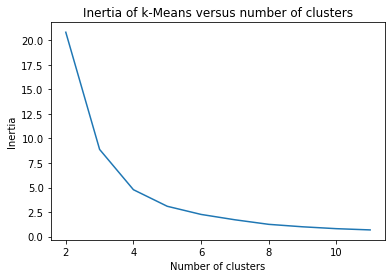

In [47]:
# Clustering Sims-Tariffs-Brands

# Elbow method to find out which k is the best for the k-means clustering

# SIM - TARIFF
normalizedVector = preprocessing.normalize(brands_event_successfully_orders)

scoresBrandEvent = [KMeans(n_clusters=i+2).fit(normalizedVector).inertia_ for i in range(10)]
sns.lineplot(np.arange(2, 12), scoresBrandEvent)
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means versus number of clusters")

In [48]:
# Crate a kmeans objects
kmeansSimEvent = KMeans(n_clusters=3)

In [49]:
# fit the Kmeans object to the dataset
kmeansSimEvent.fit(normalizedVector)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=3, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

In [50]:
#pca_Tariff_Sim = prepare_pca(2, normalizedVector, kmeansTariffSim.labels_)
#sns.scatterplot(x=normalizedVector.x, y=normalizedVector.y)

In [51]:

#sns.scatterplot(x=pca_Tariff_Sim.x, y=pca_Tariff_Sim.y, hue=pca_df.labels)

In [52]:
clustersData = kmeansSimEvent.cluster_centers_

In [53]:
y_km = kmeansSimEvent.fit_predict(normalizedVector)

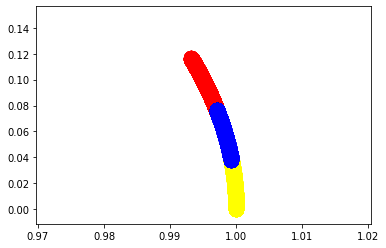

In [54]:
plt.scatter(normalizedVector[y_km == 0,0], normalizedVector[y_km == 0,1], s=200, color='red')
plt.scatter(normalizedVector[y_km == 1,0], normalizedVector[y_km == 1,1], s=200, color='yellow')
plt.scatter(normalizedVector[y_km == 2,0], normalizedVector[y_km == 2,1], s=200, color='blue')

In [55]:
df_matrix = pd.DataFrame(normalizedVector)
df_matrix['labels'] = kmeansSimEvent.labels_
df_matrix

,0,1,labels
0,0.997615,0.069020,2
1,0.997244,0.074197,2
2,0.996789,0.080078,0
3,0.999989,0.004662,1
4,0.999026,0.044122,2
...,...,...,...
84109,0.995939,0.090031,0
84110,0.998251,0.059110,2
84111,0.994587,0.103909,0
84112,0.996590,0.082516,0


In [56]:
fig = px.parallel_coordinates(df_matrix, color="labels", labels={0: "Date",
                1: "Time", "labels": "label", },
                             color_continuous_scale=px.colors.diverging.Tealrose,
                             color_continuous_midpoint=1)
fig.show()
# Date, Time und Labels
# 3 Gruppe. Eine Gruppe kauft Device am Morgen, Eine am Tag und eine am Abend.
# Auch von Date getrennt.
# 1 Jahr

In [57]:
#-----------------------------------------------
# ----------The Main Clustering----------------
#-----------------------------------------------------

Text(0.5, 1.0, 'Inertia of k-Means versus number of clusters')

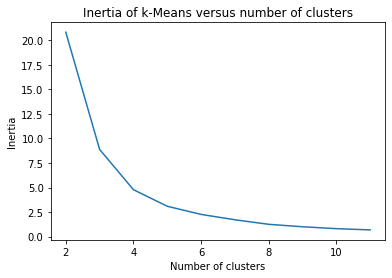

In [58]:
normalizedVectorDf1 = preprocessing.normalize(df1_for_cluster)

scoresBrandEventDf1 = [KMeans(n_clusters=i+2).fit(normalizedVector).inertia_ for i in range(10)]
sns.lineplot(np.arange(2, 12), scoresBrandEventDf1)
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means versus number of clusters")

In [59]:
# Crate a kmeans objects
kmeansDf1 = KMeans(n_clusters=4)

In [60]:
# fit the Kmeans object to the dataset
kmeansDf1.fit(normalizedVectorDf1)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=4, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

In [61]:
clustersDataDf1 = kmeansDf1.cluster_centers_

In [62]:
y_km = kmeansDf1.fit_predict(normalizedVectorDf1)

In [63]:
#plt.scatter(normalizedVectorDf1[y_km == 0,0], normalizedVector[y_km == 0,1], s=200, color='red')
#plt.scatter(normalizedVectorDf1[y_km == 1,0], normalizedVector[y_km == 1,1], s=200, color='yellow')
#plt.scatter(normalizedVectorDf1[y_km == 2,0], normalizedVector[y_km == 2,1], s=200, color='blue')

IndexError: boolean index did not match indexed array along dimension 0; dimension is 84114 but corresponding boolean dimension is 263253

In [65]:
df1_matrix = pd.DataFrame(normalizedVectorDf1)
df1_matrix['labels'] = kmeansDf1.labels_
df1_matrix

,0,1,2,3,4,5,6,7,8,9,labels
0,0.000117,0.000019,0.000001,0.993297,0.115586,0.000004,0.000053,0.000013,0.000005,0.000001,1
1,0.986854,0.158804,0.011343,-0.011343,-0.011343,-0.011343,-0.011343,-0.011343,-0.011343,0.000000,2
2,0.987145,0.157046,0.011218,-0.011218,-0.011218,-0.011218,-0.011218,-0.011218,-0.011218,0.000000,2
3,0.986854,0.158804,0.011343,-0.011343,-0.011343,-0.011343,-0.011343,-0.011343,-0.011343,0.000000,2
4,0.999274,-0.011486,0.022972,-0.011486,-0.011486,-0.011486,-0.011486,-0.011486,-0.011486,0.000000,2
...,...,...,...,...,...,...,...,...,...,...,...
263248,-0.000001,-0.000001,0.000012,0.996590,0.082516,0.000000,0.000064,0.000015,0.000035,0.000001,1
263249,-0.106000,-0.106000,0.953998,-0.106000,-0.106000,-0.106000,-0.106000,-0.106000,-0.106000,0.000000,0
263250,-0.000001,-0.000001,0.000012,0.998119,0.061306,0.000003,0.000064,0.000015,0.000038,0.000001,1
263251,-0.106000,-0.106000,0.953998,-0.106000,-0.106000,-0.106000,-0.106000,-0.106000,-0.106000,0.000000,0


In [100]:
figDf1 = px.parallel_coordinates(df1_matrix, color="labels", labels={0: "TARIFF", 1: "SIM", 2: "BRAND", 3: "DATE", 4: "TIME", 5: "WEEKDAY",
                                                                     6: "WEEK OF YEAR", 7: "MONTH", 8: "DAY", 9: "SUCCESS"},
                             color_continuous_scale=px.colors.diverging.Tealrose,
                             color_continuous_midpoint=2)
figDf1.show()
# Date, Time und Labels
# 3 Gruppe. Eine Gruppe kauft Device am Morgen, Eine am Tag und eine am Abend.
# Auch von Date getrennt.
# 1 Jahr

SyntaxError: invalid syntax (<ipython-input-100-54379f3cb9ae>, line 1)

In [ ]:
# UNSUCCESSFULLY ORDER WITH WEEK DAYS AND PARTS OF THE DAY

data_x=[              'Monntag',
                      'Dienstag',
                      'Mittwoch',
                      'Donnerstag',
                      'Freitag',
                      'Samstag',
                      'Sonntag'
                     ]

data_y=[
                      'Morgen',
                      'Nachmittag',
                      'Abend',
                      'Nacht'
                     ]

data = [go.Heatmap(z=dfUnsuccessfullyOrder.values.tolist(), 
                   y=data_y,
                   x=data_x,
                   colorscale='Viridis')]

plotly.offline.iplot(data, filename='pandas-heatmap')

In [ ]:
# SUCCESSFULLY ORDER WITH WEEK DAYS AND PARTS OF THE DAY

data = [go.Heatmap(z=dfSuccessfullyOrder.values.tolist(), 
                   y=data_y,
                   x=data_x,
                   colorscale='Viridis')]

plotly.offline.iplot(data, filename='pandas-heatmap')

In [ ]:
# SUCCESSFULLY ORDER WITH WEEK DAYS AND PARTS OF THE DAY

data = [go.Heatmap(z=successfullyOrderWithPercent.values.tolist(), 
                   y=data_y,
                   x=data_x,
                   colorscale='Viridis')]

plotly.offline.iplot(data, filename='pandas-heatmap')


In [ ]:
df_matrix